In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from tqdm.auto import tqdm
import _pickle as pickle
from PIL import Image
import os

import requests
import cv2

%load_ext autoreload
%autoreload 2

import sys
sys.path.append("../../")

In [2]:
from bechdelai.utils.video import extract_frames_from_videos
from bechdelai.vision.video import Video

# Paths

## Trailer

In [241]:
hp_path = r"C:\Users\theo.alvesdacosta\Videos\HP"
print(os.listdir(hp_path))

hp_path = [os.path.join(hp_path,x) for x in os.listdir(hp_path)]
hp4_path = hp_path[2]
hp4_path

["Harry Potter et l'Ordre du Phoenix - Bande Annonce Officielle (VF) - Daniel Radcliffe - Emma Wan.mp4", 'Harry Potter et la Chambre des Secrets - Bande Annonce Officielle (VF) - Daniel Radcliffe.mp4', 'Harry Potter et la Coupe de Feu - Bande Annonce Officielle (VF) - Daniel Radcliffe - Emma Watson.mp4', 'Harry Potter et le Prince de Sang-Mêlé - Bande Annonce Officielle 3 (VF) - Daniel Radcliffe.mp4', "Harry Potter et le Prisonnier d'Azkaban - Bande Annonce Officielle (VF) - Daniel Radcliffe.mp4", 'Harry Potter et Les Reliques de la Mort - Partie 1 - Bande Annonce Officielle (VF).mp4', 'Harry Potter et Les Reliques de la Mort - Partie 2 - Bande Annonce Officielle (VF).mp4', "Harry Potter à l'École des Sorciers - Bande Annonce Officielle (VF) - Daniel Radcliffe.mp4"]


'C:\\Users\\theo.alvesdacosta\\Videos\\HP\\Harry Potter et la Coupe de Feu - Bande Annonce Officielle (VF) - Daniel Radcliffe - Emma Watson.mp4'

## Full movie

In [100]:
video_folder = "C:/Users/theo.alvesdacosta/videos"
hp4_path = "Harry Potter 4 and the Goblet of Fire (et la Coupe de Feu) (2005) 720p VOST by NsX [MKV Corp].mkv"
hp4_path = os.path.join(video_folder,hp4_path)

# Load & prepare images

  0%|          | 0/257 [00:00<?, ?it/s]

  0%|          | 0/257 [00:00<?, ?it/s]

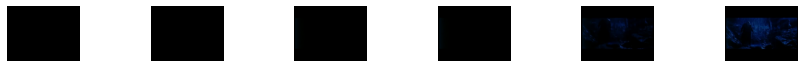

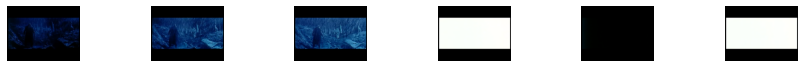

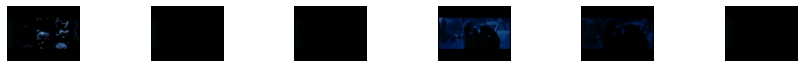

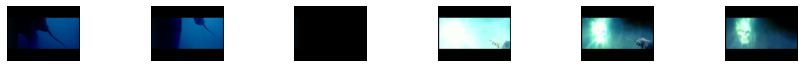

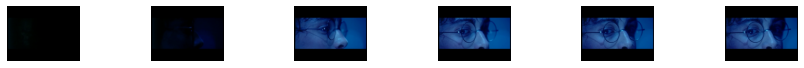

...

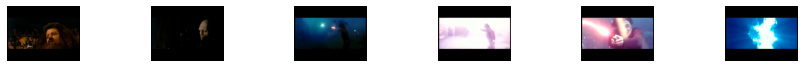

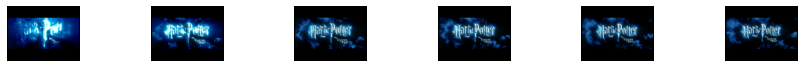

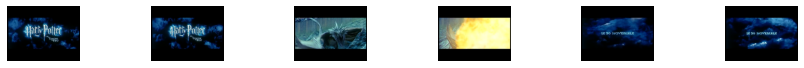

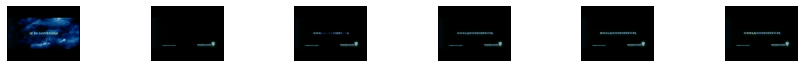

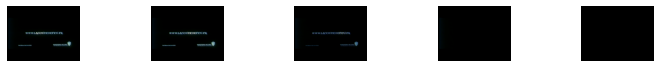

In [244]:
video = Video(path = hp4_path,frame_rate = 2,max_seconds = None)
video.resize(width = 800)
video.show_frames()

In [245]:
video.replay()

interactive(children=(Play(value=0, description='Press play', interval=500, max=256), Output()), _dom_classes=…

IntSlider(value=0, max=256)

# Apply CLIP algorithm

In [246]:
from bechdelai.vision.clip import CLIP

In [247]:
from bechdelai.utils.timeline import convert_to_timeline,fn_timeline

import plotly.express as px

In [248]:
clip = CLIP()

Loading CLIP model


In [273]:
0
46
56
78-81
87
96
106-108
115

0

In [267]:
prompts_dict =  {
    "Base":[
        "background",
        "a black or colored screen with texts",
        "blank",
        "unknown",
        "a blurry picture",
    ],
    "Landscape":[
        'an urban area',
        'a building',
        'a nature landscape',
        'a city street',
        'a school',
        'inside a house',
    ],
    "Romantic":[
        'a woman is undressed, naked, or shown in a sexy way',
        'women breasts',
        'people kissing',
        'couple making love',
    ],
    "Action":[
        "people flying on brooms",
    ],
    "Dialogue":[
        'a young woman',
        'a young man',
        'an old woman',
        'an old man',
        'two women speaking together',
        'two men speaking together',
        'a man and a woman speaking together',
        'a group of persons',
        'a group of men',
        'a group of women',
    ]
}

clip.set_prompts(prompts_dict)

In [268]:
%%time
preds,probas = clip.predict(video)

CPU times: total: 1min 20s
Wall time: 25.5 s


In [269]:
# preds_reduced = clip.reduce_preds_by_category(preds)

In [270]:
# clip.show_preds_area(probas)

In [271]:
def make_fig_frame_probas(probas,i,clip):
    probas_frame = probas.iloc[i].reset_index()
    probas_frame.columns = ["prompt","proba"]
    probas_frame = probas_frame.sort_values("proba",ascending = False)
    probas_frame = probas_frame.merge(clip.prompts,on = "prompt")
    fig = px.bar(probas_frame,x = "prompt",y = "proba",color = "category",category_orders={'prompt': probas_frame["prompt"].tolist()})
    return fig

In [272]:
clip.replay(video,probas)

interactive(children=(Play(value=0, description='Press play', interval=500, max=256), Output()), _dom_classes=…

IntSlider(value=0, max=256)

In [255]:
x = (preds.melt(ignore_index = False)
    .reset_index(drop = False)
    .rename(columns = {"index":"frame_id","variable":"prompt"})
)

x["rank"] = x.groupby(["frame_id"])["value"].transform("rank",ascending = False)

x = x.query("rank<=1")

x = x.merge(clip.prompts,on = "prompt").sort_values("frame_id")

x["sequence_id"] = x.groupby("prompt")["frame_id"].transform(fn_timeline)

timeline = convert_to_timeline(x,"prompt",show = False,xaxis_time=True)
timeline = timeline.merge(clip.prompts,on = "prompt")

In [256]:
fig = px.timeline(timeline,
  x_start = "start",
  x_end = "end",
  color = "prompt",
  y = "category",
#     facet_row = "category",
  color_discrete_sequence = px.colors.qualitative.Alphabet
)
fig.update_layout(legend=dict(
    orientation="h",
    yanchor="bottom",
    y=-0.5,
    xanchor="right",
    x=1
))
# fig.update_layout(showlegend=False)
fig

In [23]:
from scipy.special import softmax

In [24]:
preds_cat = (preds
 .melt(ignore_index = False)
 .reset_index()
 .rename(columns = {"index":"frame_id","variable":"prompt"})
 .merge(clip.prompts,on = "prompt")
 .groupby(["frame_id","category"]).agg({"value":"max"})["value"]
 .unstack("category")
)

preds_cat = softmax(preds_cat,axis = 1)

In [25]:
preds_for_timeline = preds_cat.melt(ignore_index = False).reset_index().query("value > 0.5")
preds_for_timeline

,frame_id,category,value
0,0,Base,0.960589
1,1,Base,0.953553
2,2,Base,0.938858
3,3,Base,0.967683
4,4,Base,0.960882
...,...,...,...
688,127,Romantic,0.791574
689,128,Romantic,0.767591
718,157,Romantic,0.512598
721,160,Romantic,0.744554


In [29]:
# timeline = convert_to_timeline(
#     preds_for_timeline,
#     "category",
#     show = True,
#     xaxis_time = True,
# )
# timeline

In [27]:
clip.show_preds_area(preds_cat)

In [28]:
clip.replay(video,preds_cat)

interactive(children=(Play(value=0, description='Press play', interval=500, max=186), Output()), _dom_classes=…

IntSlider(value=0, max=186)

# Faces

In [102]:
from bechdelai.vision.faces import FacesDetector

In [103]:
video.extract_faces(backend = "opencv")

  0%|          | 0/946 [00:00<?, ?it/s]

In [106]:
video.faces_metadata.shape

(512, 2)

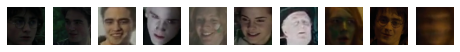

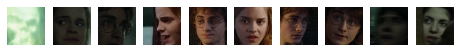

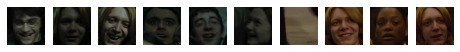

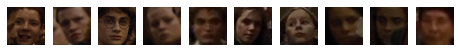

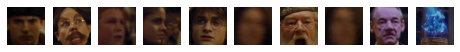

...

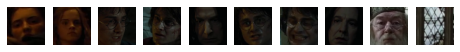

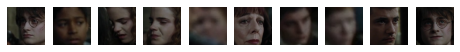

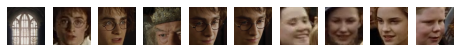

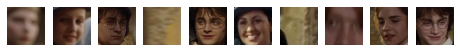

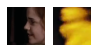

In [104]:
video.show_all_faces()

In [109]:
faces_embedding = video.make_faces_embeddings()

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: module 'gast' has no attribute 'Constant'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


In [110]:
faces_embedding.shape

(512, 2622)

In [111]:
from bechdelai.vision.old.face_recognition import FaceAnalyzer

In [112]:
fa = FaceAnalyzer()

In [144]:
n = 1000

In [220]:
%%time
embeddings2D = fa.reduce_embeddings(faces_embedding[:n],n_neighbors=200, min_dist=0.0, n_components=2, metric='cosine')

CPU times: total: 8.41 s
Wall time: 3.69 s



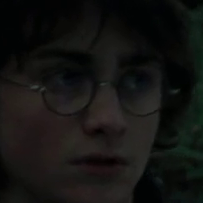
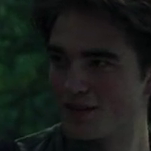
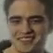
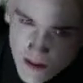
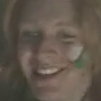
...
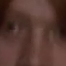
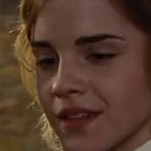
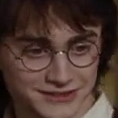
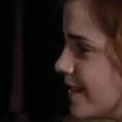
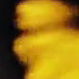

In [240]:
embeddings2D,clusters = fa.cluster_embeddings(embeddings2D,eps = 0.5)
fa.show_embeddings2D(embeddings2D,faces = video.faces[:n])